<a href="https://colab.research.google.com/github/EylonYehiel/projects/blob/main/fifa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### source : https://www.kaggle.com/datasets/sanjeetsinghnaik/fifa-23-players-dataset

---
<div style="text-align:center">
<img src="https://raw.githubusercontent.com/EylonYehiel/projects/main/images/fifa23.jpg" width="750"/>
<div>

In [42]:
from pyforest import *
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp
from plotly.subplots import make_subplots
import sidetable
import math
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import geopandas as gpd
import warnings
warnings.filterwarnings('ignore')

In [43]:
fifa = pd.read_csv("https://raw.githubusercontent.com/EylonYehiel/projects/main/Data/Fifa%2023%20Players%20Data.csv")

<IPython.core.display.Javascript object>

In [44]:
fifa.sample(5)

,Known As,Full Name,Overall,Potential,Value(in Euro),Positions Played,Best Position,Nationality,Image Link,Age,...,LM Rating,CM Rating,RM Rating,LWB Rating,CDM Rating,RWB Rating,LB Rating,CB Rating,RB Rating,GK Rating
2372,S. Caulker,Steven Caulker,73,73,2500000,CB,CB,Sierra Leone,https://cdn.sofifa.net/players/193/504/23_60.png,30,...,54,60,54,67,71,67,69,73,69,20
4666,G. Diangana,Grady Diangana,70,76,2500000,"LM,ST,RM",CAM,England,https://cdn.sofifa.net/players/231/436/23_60.png,24,...,71,64,71,55,50,55,51,41,51,17
10247,A. Jung,Andrew Jung,65,71,1100000,ST,ST,France,https://cdn.sofifa.net/players/236/829/23_60.png,24,...,58,55,58,46,47,46,45,47,45,20
6859,M. Garay,Martín Garay,68,77,2600000,"RB,RM",RB,Argentina,https://cdn.sofifa.net/players/261/155/23_60.png,23,...,63,59,63,68,62,68,68,62,68,17
4041,M. Meli,Marcelo Meli,71,71,1800000,"CM,RM",CM,Argentina,https://cdn.sofifa.net/players/215/358/23_60.png,30,...,71,71,71,71,71,71,71,71,71,19


In [45]:
fifa.shape

(18539, 89)

In [46]:
fifa.stb.missing().sum()

missing          0.0
total      1649971.0
percent          0.0
dtype: float64

In [47]:
fifa.columns

Index(['Known As', 'Full Name', 'Overall', 'Potential', 'Value(in Euro)',
       'Positions Played', 'Best Position', 'Nationality', 'Image Link', 'Age',
       'Height(in cm)', 'Weight(in kg)', 'TotalStats', 'BaseStats',
       'Club Name', 'Wage(in Euro)', 'Release Clause', 'Club Position',
       'Contract Until', 'Club Jersey Number', 'Joined On', 'On Loan',
       'Preferred Foot', 'Weak Foot Rating', 'Skill Moves',
       'International Reputation', 'National Team Name',
       'National Team Image Link', 'National Team Position',
       'National Team Jersey Number', 'Attacking Work Rate',
       'Defensive Work Rate', 'Pace Total', 'Shooting Total', 'Passing Total',
       'Dribbling Total', 'Defending Total', 'Physicality Total', 'Crossing',
       'Finishing', 'Heading Accuracy', 'Short Passing', 'Volleys',
       'Dribbling', 'Curve', 'Freekick Accuracy', 'LongPassing', 'BallControl',
       'Acceleration', 'Sprint Speed', 'Agility', 'Reactions', 'Balance',
       'Shot Powe

In [48]:
fifa.describe()

,Overall,Potential,Value(in Euro),Age,Height(in cm),Weight(in kg),TotalStats,BaseStats,Wage(in Euro),Release Clause,...,LM Rating,CM Rating,RM Rating,LWB Rating,CDM Rating,RWB Rating,LB Rating,CB Rating,RB Rating,GK Rating
count,18539.000000,18539.000000,1.853900e+04,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000,1.853900e+04,...,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000,18539.000000
mean,65.852042,71.016668,2.875461e+06,25.240412,181.550839,75.173904,1602.114569,357.946221,8824.537462,5.081688e+06,...,58.451319,57.374076,58.451319,56.281569,55.928583,56.281569,55.650251,54.528184,55.650251,23.257134
std,6.788353,6.192866,7.635129e+06,4.718163,6.858097,7.013593,273.160237,39.628259,19460.531154,1.467203e+07,...,13.987122,13.171194,13.987122,13.903836,13.872190,13.903836,14.159466,14.743929,14.159466,15.108925
min,47.000000,48.000000,0.000000e+00,16.000000,155.000000,49.000000,759.000000,224.000000,0.000000,0.000000e+00,...,18.000000,18.000000,18.000000,17.000000,19.000000,17.000000,17.000000,18.000000,17.000000,10.000000
25%,62.000000,67.000000,4.750000e+05,21.000000,177.000000,70.000000,1470.000000,331.000000,1000.000000,6.650000e+05,...,54.000000,53.000000,54.000000,51.000000,48.000000,51.000000,49.000000,45.000000,49.000000,17.000000
50%,66.000000,71.000000,1.000000e+06,25.000000,182.000000,75.000000,1640.000000,358.000000,3000.000000,1.500000e+06,...,62.000000,60.000000,62.000000,59.000000,59.000000,59.000000,59.000000,58.000000,59.000000,18.000000
75%,70.000000,75.000000,2.000000e+06,29.000000,186.000000,80.000000,1786.000000,385.000000,8000.000000,3.400000e+06,...,67.000000,66.000000,67.000000,66.000000,66.000000,66.000000,65.000000,66.000000,65.000000,20.000000
max,91.000000,95.000000,1.905000e+08,44.000000,206.000000,105.000000,2312.000000,502.000000,450000.000000,3.667000e+08,...,92.000000,91.000000,92.000000,88.000000,89.000000,88.000000,87.000000,90.000000,87.000000,90.000000


---

In [49]:
def bold(text):
    return ("\033[1m" + f"{text}" + "\033[0m")

---

## Basic-Features Distributions

In [50]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=fifa['Age'], name='Age', xbins = dict(size=1)))
fig.add_trace(go.Histogram(x=fifa['Height(in cm)'], name='Height (cm)'))
fig.add_trace(go.Histogram(x=fifa['Weight(in kg)'], name='Weight (kg)'))
fig.update_layout(height=600, width=1100, title='Histograms of Attributes :', xaxis_title_text='Attribute Value', yaxis_title_text='Frequency')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 500x500 with 0 Axes>

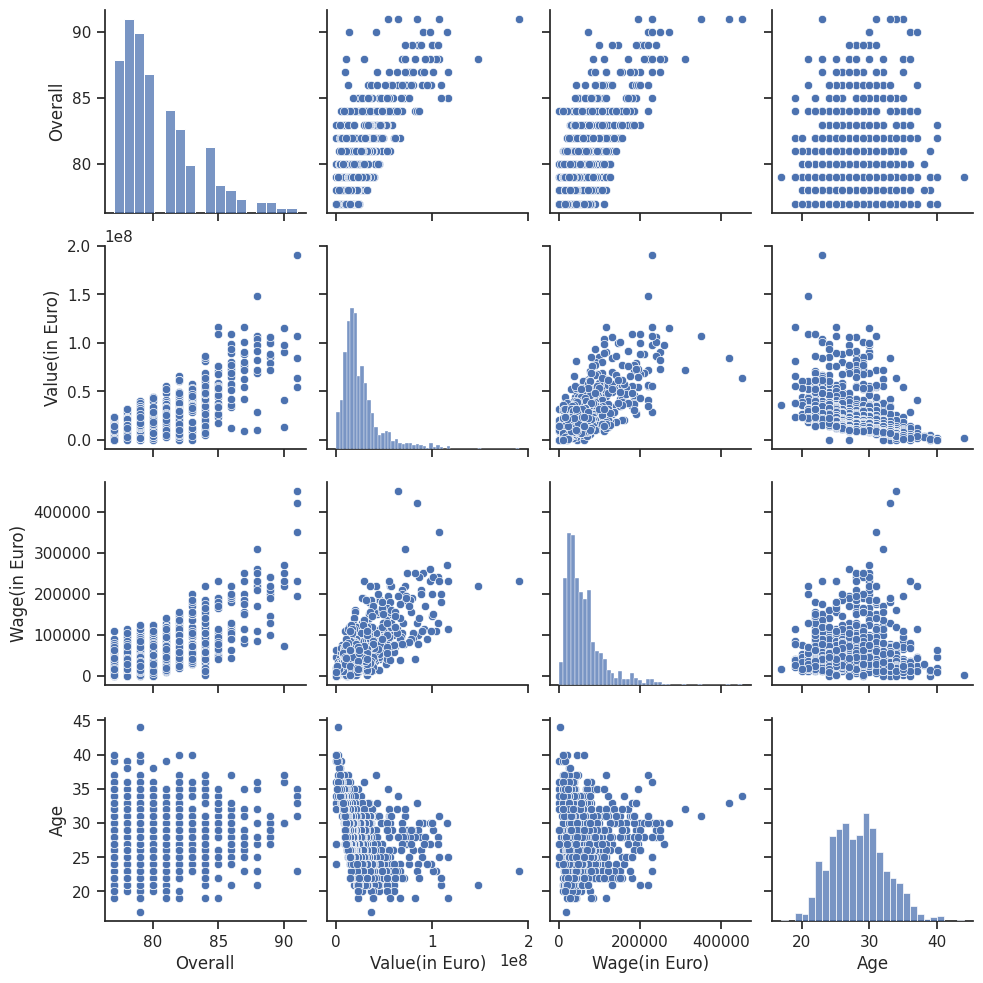

In [51]:
df = pd.DataFrame(fifa.head(1000))
numeric_columns = ['Overall', 'Value(in Euro)', 'Wage(in Euro)', 'Age']

sns.set(style="ticks")
plt.figure(figsize=(5,5))
sns.pairplot(df[numeric_columns])
plt.show();

---

In [52]:
foot = fifa['Preferred Foot'].value_counts()
trace1 = go.Pie(labels=['Right','Left'],values=[foot[0],foot[1]],
    hoverinfo='label+value', textinfo='percent', textfont=dict(size=18),
    marker=dict(colors=['#DC143C','#FFA500'],line=dict(color='#FFFFFF', width=4)), pull=[0, 0.1])

left_percentage = 11.5      # Average percantage of left-handed people (Wikipedia)
right_percentage = 88.5
trace2 = go.Pie(labels=['Right', 'Left'], values=[right_percentage, left_percentage],
    hoverinfo='label+percent', textinfo='percent', textfont=dict(size=18),
    marker=dict(colors=['#DC143C', '#FFA500'], line=dict(color='#FFFFFF', width=4)), pull=[0, 0.1])

In [53]:
fig = make_subplots(1, 2, specs=[[{'type':'domain'}, {'type':'domain'}]], subplot_titles=['Population', 'Footballers'])
fig.add_trace(trace1, 1, 2)
fig.add_trace(trace2, 1, 1)
fig.update_layout(title_text='Strong side (Right or Left) - football players VS whole population :', height = 600, width = 1000)
fig.show()

* Assuming being left-handed means left with legs either.
#### It can be seen that the percentage of left-strong-sided among football players is more than twice the percentage of left-handed people in the general population. Coincidence?

---

## By Positions :

<div style="text-align:center">
<img src="https://raw.githubusercontent.com/EylonYehiel/projects/main/images/positionsmap.jpg" width="750"/>
<div>

In [54]:
fig = px.histogram(fifa, x="Age", color="Best Position", nbins=55)
fig.update_layout(height=450, width=1100, title='Ages distribution by positions', yaxis_title_text='Frequency')
fig.show()

fig = px.histogram(fifa, x="Weight(in kg)", color="Best Position", nbins=55)
fig.update_layout(height=450, width=1100, title='Weight distribution by positions', yaxis_title_text='Frequency')
fig.show()

fig = px.histogram(fifa, x="Height(in cm)", color="Best Position", nbins=50)
fig.update_layout(height=450, width=1100, title='Height distribution by positions', yaxis_title_text='Frequency')
fig.show()

---

<IPython.core.display.Javascript object>

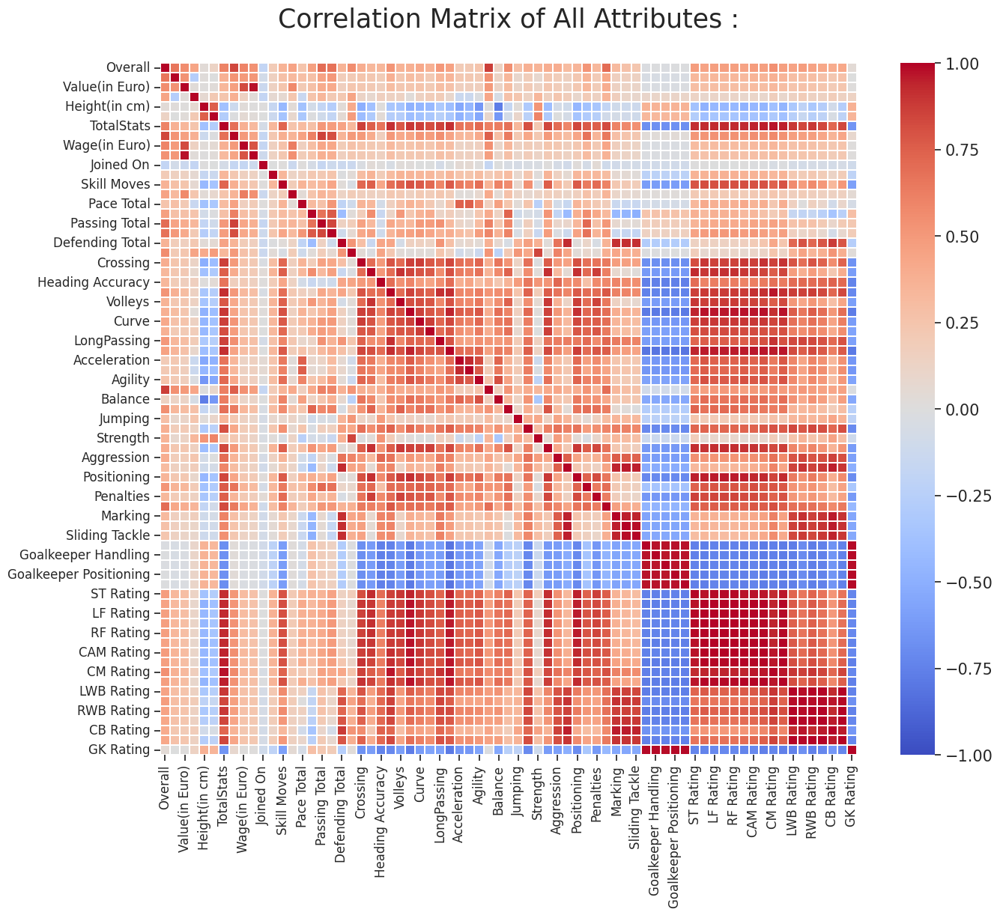

In [55]:
fig, ax = plt.subplots(figsize=(15,12))
sns.heatmap(fifa.corr(), cmap='coolwarm', vmin=-1, vmax=1, fmt='.2f', linewidths=0.05, ax=ax)
ax.set_title('Correlation Matrix of All Attributes :\n', fontsize=25)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=15)

plt.show()

#### Not really readable, we need to reduce the load

In [56]:
fig = px.imshow(fifa[['Overall','Reactions','Composure','Passing Total','Wage(in Euro)','Value(in Euro)','Shot Power','Age']].corr(), color_continuous_scale='OrRd', zmin=0, zmax=1)
fig.update_layout(width=800, height=600, title='Strong Connnections Zoom-in:')
fig.show()

#### Random forest model to predict player's overall rank by his **reactions, composure** and **passing** scores, his **wage** and his **age** :

In [57]:
features = ['Reactions', 'Composure','Passing Total', 'Wage(in Euro)', 'Age']
target = 'Overall'
X_train, X_test, y_train, y_test = train_test_split(fifa[features], fifa[target], test_size=0.2, random_state=42)
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

#### Test:

In [58]:
mse = mean_squared_error(y_test, y_pred)
rmse = mse ** 0.5
r2_score = model.score(X_test, y_test)
print("RMSE: " + bold(rmse))
print("r^2:  " + bold(r2_score))

RMSE: 2.397600706049064
r^2:  0.8728423345934998


<div style="text-align:">
    <img src="https://yomamen.com/data/wp-content/uploads/2018/08/skysports-pep-guardiola-manchester-city_4321207.jpg" alt="pep" style="width: 450px; height:300px;">
</div>


In [59]:
importances = model.feature_importances_
print("Feature Importances:")
for feature, importance in zip(features, importances):
    print(f"{feature}: {importance}")

Feature Importances:
Reactions: 0.7533940990013311
Composure: 0.0477126165822238
Passing Total: 0.0744110088582221
Wage(in Euro): 0.08892444372035122
Age: 0.03555783183787179


In [60]:
fig = px.scatter(x=y_test, y=y_pred, labels={'x': 'Actual Score', 'y': 'Predicted Score'}, title='Actual vs. Predicted Overall Ratings:',
                 trendline='ols')
fig.update_layout(height = 500)
fig.show()

#### Create prediction function:

In [61]:
def pred(Reactions, Composure, Pass, Wage, Age):
    p = model.predict([[Reactions,Composure,Pass,Wage,Age]])
    print(f"Overall score for {Reactions, Composure, Pass, Wage, Age} values is : {float(p)}")

In [62]:
pred(81,64,90,50000,28)
pred(78,86,70,100000,30)
pred(94,90,60,700000,21)
pred(94,80,80,60000,22)

Overall score for (81, 64, 90, 50000, 28) values is : 83.17
Overall score for (78, 86, 70, 100000, 30) values is : 79.7
Overall score for (94, 90, 60, 700000, 21) values is : 90.52
Overall score for (94, 80, 80, 60000, 22) values is : 85.2


---

In [63]:
general_features = ['Full Name', 'Age', 'Height(in cm)', 'Weight(in kg)', 'Nationality','Overall','Potential',
                    'Value(in Euro)', 'Wage(in Euro)', 'Sprint Speed', 'Defending Total', 'Dribbling Total',
                    'Pace Total', 'Shooting Total', 'Passing Total', 'Physicality Total', 'Best Position',
                    'Club Name','Preferred Foot','BaseStats','TotalStats','International Reputation','Weak Foot Rating']

## Top field players :

In [64]:
fields = fifa[general_features][fifa['Best Position'] != 'GK']
fields.sort_values(['Overall','TotalStats','Value(in Euro)'], ascending = False).head(10)

,Full Name,Age,Height(in cm),Weight(in kg),Nationality,Overall,Potential,Value(in Euro),Wage(in Euro),Sprint Speed,...,Shooting Total,Passing Total,Physicality Total,Best Position,Club Name,Preferred Foot,BaseStats,TotalStats,International Reputation,Weak Foot Rating
3,Kevin De Bruyne,31,181,70,Belgium,91,91,107500000,350000,73,...,88,93,77,CM,Manchester City,Right,483,2303,4,5
2,Robert Lewandowski,33,185,81,Poland,91,91,84000000,420000,75,...,91,79,83,ST,FC Barcelona,Right,458,2205,5,4
0,Lionel Messi,35,169,67,Argentina,91,91,54000000,195000,76,...,89,90,64,CAM,Paris Saint-Germain,Left,452,2190,5,4
4,Kylian Mbappé,23,182,73,France,91,95,190500000,230000,97,...,89,80,76,ST,Paris Saint-Germain,Right,470,2177,4,4
1,Karim Benzema,34,185,81,France,91,91,64000000,450000,80,...,88,83,78,CF,Real Madrid CF,Right,455,2147,4,4
5,Mohamed Salah,30,175,71,Egypt,90,90,115500000,270000,91,...,89,82,75,RW,Liverpool,Left,471,2226,4,3
8,C. Ronaldo dos Santos Aveiro,37,187,83,Portugal,90,90,41000000,220000,83,...,92,78,75,ST,Manchester United,Right,445,2159,5,4
9,Virgil van Dijk,30,193,92,Netherlands,90,90,98000000,230000,91,...,60,71,86,CB,Liverpool,Right,461,2117,4,3
17,Joshua Kimmich,27,177,75,Germany,89,90,105500000,130000,60,...,72,87,79,CDM,FC Bayern München,Right,473,2283,4,4
13,Carlos Henrique Venancio Casimiro,30,185,84,Brazil,89,89,86000000,240000,66,...,73,75,90,CDM,Manchester United,Right,460,2209,3,3


## Top goalies :

In [65]:
goalies = fifa[fifa['Best Position'] == 'GK']
goalies[general_features].sort_values(['Overall','TotalStats','Value(in Euro)'], ascending = False).head(10)

,Full Name,Age,Height(in cm),Weight(in kg),Nationality,Overall,Potential,Value(in Euro),Wage(in Euro),Sprint Speed,...,Shooting Total,Passing Total,Physicality Total,Best Position,Club Name,Preferred Foot,BaseStats,TotalStats,International Reputation,Weak Foot Rating
7,Manuel Neuer,36,193,93,Germany,90,90,13500000,72000,60,...,88,91,91,GK,FC Bayern München,Right,501,1535,5,4
6,Thibaut Courtois,30,199,96,Belgium,90,91,90000000,250000,52,...,89,75,89,GK,Real Madrid CF,Left,473,1334,4,3
16,Ederson Santana de Moraes,28,188,86,Brazil,89,91,88000000,210000,63,...,82,93,88,GK,Manchester City,Left,502,1583,3,3
18,Alisson Ramses Becker,29,191,91,Brazil,89,90,79000000,190000,49,...,85,85,90,GK,Liverpool,Right,489,1437,3,3
14,Jan Oblak,29,188,87,Slovenia,89,91,85500000,100000,58,...,90,78,87,GK,Atlético de Madrid,Right,479,1402,5,3
27,Marc-André ter Stegen,30,187,85,Germany,88,89,68500000,210000,50,...,85,87,85,GK,FC Barcelona,Right,480,1443,4,4
26,Keylor Navas,35,185,80,Costa Rica,88,88,10000000,85000,53,...,84,75,87,GK,Paris Saint-Germain,Right,478,1428,3,3
22,Gianluigi Donnarumma,23,196,90,Italy,88,92,103500000,110000,55,...,83,79,85,GK,Paris Saint-Germain,Right,478,1375,3,3
37,Mike Maignan,26,191,89,France,87,90,80000000,90000,53,...,82,85,85,GK,AC Milan,Right,477,1496,2,4
35,David De Gea Quintana,31,192,76,Spain,87,87,42000000,150000,50,...,80,76,84,GK,Manchester United,Right,468,1415,4,3


---

## From which country do most players come from?
* Define the best players by their : Overall rating -> Total Statsistics -> Value.

In [66]:
best = fifa.sort_values(['Overall','TotalStats','Value(in Euro)'], ascending = False)
x = best.Nationality.value_counts().head(20)
colors = ['red', 'gold', 'orange', 'blue', 'turquoise', 'green', 'indigo', 'purple', 'brown', 'teal']
fig = go.Figure([go.Bar(x=x.index, y=x.values, marker_color=colors)])
fig.update_layout(width=900, height=500, title='Top 20 origin nationalities :' , xaxis_title='Nationality', yaxis_title='Number of Players')
fig.show()

### Import coordinates for countries display :

In [67]:
coordinates = pd.read_csv("https://raw.githubusercontent.com/EylonYehiel/projects/main/Data/world_and_usa_states_coordinated.csv")
coordinates = coordinates[['country', 'latitude', 'longitude']].rename(columns={'country':'Nationality'})
coordinates.iloc[73,0] = 'England' # Adjust the several names of England int one
cofifa = fifa.merge(coordinates, on = 'Nationality')
cofifa = cofifa[['Full Name','Nationality','latitude', 'longitude','Overall', 'Value(in Euro)', 'Age', 'Club Name','International Reputation']]
cofifa.sample(7)

<IPython.core.display.Javascript object>

,Full Name,Nationality,latitude,longitude,Overall,Value(in Euro),Age,Club Name,International Reputation
16436,Darwin Cerén,El Salvador,13.794185,-88.896530,68,800000,32,Houston Dynamo,1
6621,Evandro Sérgio Rochedo Paulino,Brazil,-14.235004,-51.925280,72,2600000,26,Clube Atlético Mineiro,1
12863,Jacob Greene,United States,37.090240,-95.712891,51,150000,19,D.C. United,1
13921,José Quintero,Ecuador,-1.831239,-78.183406,67,700000,32,LDU Quito,1
8077,Roberto Romeo,Italy,41.871940,12.567380,62,275000,32,Universitatea Cluj,1
13995,Denilson Ovando,Ecuador,-1.831239,-78.183406,62,950000,20,Caracas Fútbol Club,1
7008,Leo Štulac,Slovenia,46.151241,14.995463,71,2000000,27,Palermo,1


## Players origin distribution on the map:

In [68]:
world_map = folium.Map(location=[0, 0], zoom_start=1.5, width=850, height=500)
mc = MarkerCluster()
for idx, row in cofifa.iterrows():
    if not math.isnan(row['longitude']) and not math.isnan(row['latitude']):
        mc.add_child(Marker([row['latitude'], row['longitude']], popup=f"<b>Full Name:</b>{row['Full Name']}\n<b>\nClub Name:</b> ({row['Club Name']})<br><b>Nationality:</b> {row['Nationality']}<br><b>Age:</b> {row['Age']}"))
world_map.add_child(mc)
world_map

---

### Nationalities frequency of Top 500 players (Overall rate):
* The frequency calculated by overall rating sum.

In [69]:
best2 = best.head(500).groupby('Nationality').sum().sort_values('Overall',ascending = False).reset_index()
fig = px.choropleth(best2, locations="Nationality", color="Overall", color_continuous_scale="Reds", hover_data=["Nationality", "Overall"], locationmode="country names")
fig.update_layout(title="Overall Ratings by Nationality", width=1000, height=600)
fig.update_layout(geo=dict(showframe=True, showcoastlines=False, projection_type='robinson'))
fig.show()
best2 = best2.set_index('Nationality')
best2.head(10)[['Overall']]

,Overall
Nationality,
Spain,5512
Brazil,4117
France,3887
Germany,3321
England,3221
Italy,2477
Portugal,2399
Argentina,2060
Netherlands,1640


* Greatest scores belongs to the countries of Europe & South America.

### Countries with the highest total value of **All** players:

In [70]:
best2 = best.groupby('Nationality').sum().sort_values('Overall',ascending = False)
best2 = best2.head(25).sort_values('Value(in Euro)', ascending=False)
color_scale = np.linspace(0, 1, len(best2))
colors = [f'rgb({int(c*255)}, 0, {int((1-c)*255)})' for c in color_scale]
fig = go.Figure(data=[go.Bar(x=best2.index, y=best2['Value(in Euro)'], marker=dict(color =colors))])
fig.update_layout(xaxis_title='Country', yaxis_title='Value (in Euro)', title='Sum of players\' values of Each Country:', xaxis_tickangle=-45, height = 600)
fig.show()
best2.head(10)[['Value(in Euro)']]

<IPython.core.display.Javascript object>

,Value(in Euro)
Nationality,
Spain,5184394999
France,4630494998
England,4279005000
Brazil,4272774989
Germany,3482149998
Argentina,2946924997
Italy,2631509999
Portugal,2416090000
Netherlands,1936534999


In [71]:
w = best.head(500).groupby('Nationality').size().sort_values(ascending = False)
fig = px.pie(w, values=w, names=w.index, title='Top 500 Players origin distribution:')
fig.update_layout(height = 700, width = 1050)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

## Data expansion:

* The following data set only includes international matches between national teams.

In [72]:
dat = pd.read_csv("https://raw.githubusercontent.com/EylonYehiel/projects/main/Data/goalscorers.csv")
dat.info()

<IPython.core.display.Javascript object>

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41008 entries, 0 to 41007
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   date       41008 non-null  object 
 1   home_team  41008 non-null  object 
 2   away_team  41008 non-null  object 
 3   team       41008 non-null  object 
 4   scorer     40959 non-null  object 
 5   minute     40750 non-null  float64
 6   own_goal   41008 non-null  bool   
 7   penalty    41008 non-null  bool   
dtypes: bool(2), float64(1), object(5)
memory usage: 2.0+ MB


In [73]:
goals_count = dat['team'].value_counts().reset_index()
goals_count.columns = ['Country', 'Goals']

fig = px.pie(goals_count, values='Goals', names='Country', title='Precentage (& amount) of international goals over history by Country:')
fig.update_layout(height = 800, width = 1200)
fig.update_traces(textposition='inside', textinfo='percent')
fig.show()

---

In [74]:
fig = px.histogram(dat,x = "minute",  color="penalty", color_discrete_sequence=['purple','red'])
fig.update_layout(title='Goal minute distribution:', xaxis_title='Minute of Game', height = 600)
fig.show()

In [75]:
dat = dat[dat.own_goal == False] # Ignoring own-goals
dat['goal'] = 1 # Numerize the significance of each row (a goal)
dat['cumulative'] = dat.groupby('scorer')['goal'].cumsum()
dat.set_index('date', inplace = True)
cdat = dat.sort_values('cumulative',ascending = False).reset_index()

In [76]:
cdat['date'] = pd.to_datetime(cdat['date'])
cdat['day'] = cdat['date'].dt.day  # Extract the day from the date

top = cdat.groupby('scorer').max().sort_values('cumulative', ascending=False).head(100).index
fallafel = cdat[cdat.scorer.isin(top)]
fig = px.scatter(fallafel.reset_index(), x='date', y='cumulative', color='scorer', hover_name='scorer',
                 hover_data=['scorer', 'date','day' ,'team', 'cumulative'])
fig.update_traces(mode='lines+markers', marker=dict(symbol='circle', size=5, opacity=0.8))
# option for adding a slider
# fig.update_xaxes(type='date', rangeslider_visible=True)
fig.update_layout(title="Top 100 international scorers of all times:", width=1050, height=600)
fig.show()

<IPython.core.display.Javascript object>

* Try to open a window inside the chart for zoom-in.
* Double-click a player name in the list to view its isolated information.

---

## Football teams Comparison:

In [77]:
fig = px.scatter_3d(data_frame=fifa.head(35), x='Overall', y='Wage(in Euro)', z='Value(in Euro)', color='Club Name', hover_name='Full Name')
fig.update_layout(width=800, height=600, title='Overall Rating, Value and Wage by Club - Top 35:')
fig.show()

* We can already see which teams are leading the board.

In [78]:
squad = fifa[general_features].groupby('Club Name').head(16) # Top 16 players - club's best squad
squad = squad.groupby('Club Name').mean().sort_values('Overall', ascending = False)
squad.head()

,Age,Height(in cm),Weight(in kg),Overall,Potential,Value(in Euro),Wage(in Euro),Sprint Speed,Defending Total,Dribbling Total,Pace Total,Shooting Total,Passing Total,Physicality Total,BaseStats,TotalStats,International Reputation,Weak Foot Rating
Club Name,,,,,,,,,,,,,,,,,,
Manchester City,27.2500,183.375,78.5000,85.9375,87.6250,73156250.0,202812.5,74.0625,69.6250,81.3125,75.1250,69.8125,78.8125,76.5000,451.1875,2064.0000,2.8750,3.500
Real Madrid CF,28.0000,181.500,76.7500,85.1875,87.3750,56437500.0,215625.0,79.6875,63.7500,80.8750,80.6875,70.1250,78.3750,74.8750,448.6875,2045.0625,2.6875,3.750
Liverpool,27.4375,183.375,77.6875,85.0000,87.0000,62562500.0,160312.5,75.7500,68.6875,80.3750,77.0625,67.7500,76.3750,78.1875,448.4375,2045.9375,2.5625,3.125
Paris Saint-Germain,27.6875,180.750,74.1875,85.0000,87.2500,59093750.0,119187.5,73.5625,65.5625,82.4375,78.6250,72.3750,78.5000,75.3125,452.8125,2032.1250,3.0000,3.625
FC Bayern München,25.8125,183.375,78.1250,84.5625,87.3125,58187500.0,84625.0,78.6875,64.2500,81.5000,80.6875,73.0625,77.4375,75.4375,452.3750,2061.0625,3.1250,3.500


In [79]:
pxq = px.colors.qualitative
club_names = squad.index
colors = pxq.Pastel + pxq.Vivid + pxq.G10 + pxq.Vivid + pxq.Bold + pxq.T10 + pxq.Alphabet

# Define function to rank clubs based on a specific attribute and create a bar chart trace to visualize the rankings
def rank_clubs_by_attribute_mean(attribute, title=None):
    club_colors = dict(zip(club_names, colors))
    grouped = squad.reset_index()
    grouped = grouped.sort_values(by=attribute, ascending=False)[:10][::-1]
    ncolors = [club_colors.get(club_name, 'gray') for club_name in grouped['Club Name']]
    trace = go.Bar(x=grouped[attribute], y=grouped['Club Name'], orientation='h', marker_color=ncolors)
    return trace

In [80]:
attributes = ['Value(in Euro)', 'Wage(in Euro)', 'Overall', 'Dribbling Total', 'Defending Total', 'Physicality Total', 'Pace Total', 'Sprint Speed', 'Shooting Total', 'Passing Total', 'Weak Foot Rating', 'International Reputation']
positions = [(1,1), (1,2), (2,1), (2,2), (3,1), (3,2), (4,1), (4,2), (5,1), (5,2), (6,1), (6,2)]

fig = make_subplots(rows=6, cols=2, subplot_titles = attributes, horizontal_spacing = 0.2, vertical_spacing=0.05)

def uwt(att,row,col):
    fig.add_trace(go.Bar(rank_clubs_by_attribute_mean(att, title = att), name=att), row, col)
for att, pos in zip(attributes, positions):
    uwt(att, *pos)
fig.update_layout(height=1800, width=1150 ,title_text="Ranking of clubs by various attributes' means:", showlegend=False)
fig.show()

### Summing all attributes to assess the total teams' abilities:

In [81]:
squad = fifa[general_features].groupby('Club Name').head(16) # Top 16 players - club's best squad
squad = squad.groupby('Club Name').mean().sort_values('Overall', ascending = False)
scores = []
for i in range(len(squad)):
    scores.append(sum(squad.iloc[i][3:5]) + sum(squad.iloc[i][7:]))
squad['Score'] = scores
nsquad = squad[['Score']].sort_values('Score', ascending = False).head(25)
nsquad

,Score
Club Name,
FC Bayern München,3223.0000
Manchester City,3220.3750
Real Madrid CF,3201.1250
Liverpool,3196.2500
Paris Saint-Germain,3190.1875
Atlético de Madrid,3169.4375
FC Barcelona,3157.2500
Chelsea,3145.5000
Juventus,3141.6250


In [82]:
fig = px.bar(nsquad[::-1], x='Score', y=nsquad.index[::-1], title='Teams best stats - top 25:',
             orientation='h', color='Score', color_continuous_scale='Viridis')
fig.update_layout(height=600, xaxis_title='Score', yaxis_title='Team')
fig.show()

---

---

#      &nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp; Thanks for Watching !


<div style="text-align: center;">
    <img src="https://tenor.com/view/regele-fotbalului-regele-regelemeulafotbal-regelemeulafootball-sefuluiyzsem-gif-25766031.gif" alt="Messi" style="width: 600px; height: 500px;">
</div>

---

---